# **AP155 Lab Assignment** 
## Module 6: Partial Differential Equations

_Instructions_: Answer each problem as completely as you can. Discuss **all** your answers as clearly and concisely as possible. 

_Scoring Criteria_: 50% - *correctness of code*; 50% - *discussion of the code and results*. Maximum score is **100 points** (Problems 1 and 2 are worth 50 points each).

_Due Date_: **5PM of December 21 (Tue)**


### Student Information 

_Full Name (Last Name, First Name)_: Hans Emmanuel Hernandez\
_Student No._: 2020-11387\
_Section_: THU-HX-4

### Submission Information

_Date and Time Submitted (most recent upload)_: December 12

**HONOR PLEDGE** I affirm that I have upheld the highest principles of honesty and integrity in my academic work and that this lab assignment is my own work.

**Sign here with your full name: HANS EMMANUEL HERNANDEZ** 

### Grading Information (c/o Lab Instructor)

TOTAL SCORE: **[]**/100

Score breakdown:
* Problem 1 - []/50
* Problem 2 - []/50

_Date and Time Scored (MM/DD/YYYY HH:MM AM/PM):_ 

### PROBLEM 1 (50 pts.; 50/50 for code & discussion) 
**The Schrodinger equation and the Crank-Nicolson method**

_Refer to Exercise 9.8 in the Newman text._ In this problem, you will use the Crank-Nicolson method to solve the full time-dependent Schrodinger equation and hence develop a picture of how a wavefunction evolves over time.

Consider an electron (mass $M = 9.109 \times 10^{-31}$ kg) in a box of length $L = 10^{-8}$ m. Suppose that at time $t = 0$ the wavefunction of the electron has the form

$$ \psi(x,0) = \exp\left[-\frac{(x-x_0)^2}{2\sigma^2}\right]e^{i\kappa x},$$
where $x_0 = \frac{L}{2}$, $\sigma = 1 \times 10^{-10}$ m, $\kappa = 5 \times 10^{10} {\rm m}^{-1}$,  and $\psi = 0$ on the walls at $x = 0$ and $x = L$.

1. Perform a single step of the Crank-Nicolson method for this electron, calculating the vector $\psi(t)$ of values of the wavefunction, given the initial wavefunction above and using $N = 1000$ spatial slices with $a = L/N$. Your program will have to perform the following steps. First, given the vector $\psi(0)$ at $t = 0$, you will have to multiply by the matrix $\bf{B}$ to get a vector $\bf{v} = \bf{B}\psi$. Because of the tridiagonal form of $\bf{B}$, this is fairly simple. The $i$th component of $\bf{v}$ is given by
$$ v_i = b_1\psi_i + b_2(\psi_{i+1} + \psi_{i-1}).$$

   You will also have to choose a value for the time-step $h$. A reasonable choice is $h = 10^{-18}$ s. *(15 pts.)*

2. Second you will have to solve the linear system ${\bf Ax}= {\bf v}$ for $\bf{x}$, which gives you the new value of $\psi$. You could do this using a standard linear equation solver like the function $\tt solve$ in numpy's $\tt linalg$. *(10 pts.)*

3. Once you have the code in place to perform a single step of the calculation, extend your program to perform repeated steps and hence solve for $\psi$ at a sequence of times a separation $h$ apart. Note that the matrix $\bf A$ is independent of time, so it doesn't change from one step to another. You can set up the matrix just once and then keep on reusing it for every step. *(15 pts.)*

4. Make an animation of the solution by displaying the real part of the wavefunction at each time-step. You can use the function rate from the package visual to ensure a smooth frame-rate for your animation-- see Section 3.5 on page 117 of the Newman text. 

   Run your animation for a while and describe what you see. Write a few sentences explaining in physics terms what is going on in the system. *(10 pts.)*

In [1]:
import numpy
from numpy import *
import matplotlib.pyplot
from matplotlib.pyplot import *
from matplotlib import animation
from IPython.display import Image
from scipy.fftpack import dst, idst

In [2]:
# Define the given banded function from the Newman text
def banded(Aa,va,up,down):

    # Copy the inputs and determine the size of the system
    A = copy(Aa)
    v = copy(va)
    N = len(v)

    # Gaussian elimination
    for m in range(N):

        # Normalization factor
        div = A[up,m]

        # Update the vector first
        v[m] /= div
        for k in range(1,down+1):
            if m+k<N:
                v[m+k] -= A[up+k,m]*v[m]

        # Now normalize the pivot row of A and subtract from lower ones
        for i in range(up):
            j = m + up - i
            if j<N:
                A[i,j] /= div
                for k in range(1,down+1):
                    A[i+k,j] -= A[up+k,m]*A[i,j]

    # Backsubstitution
    for m in range(N-2,-1,-1):
        for i in range(up):
            j = m + up - i
            if j<N:
                v[m] -= A[i,j]*v[j]

    return v

In [26]:
# Define the variables
h = 1e-18                      # time-step
hbar = 1.0546e-34              # planck's eponymous constant
M = 9.109e-31                  # electron mass in kg
L = 1e-8                       # length in m
N = 1000                       # slices     
x0 = L/2                       # initial value of x
sigma = 1e-10                  # constant
k = 5e10                       # constant
a = L/N                        # width

# Define matrix entries
a1 = 1 + (h*hbar*1j)/(2*M*a**2)
a2 = (-h*hbar*1j)/(4*M*a**2)
b1 =  1 - (h*hbar*1j)/(2*M*a**2)
b2 =  (h*hbar*1j)/(4*M*a**2)

# Initialize array of zeros for psi values
psi = zeros(N+1, complex)

# Define initial wavefunction
def psi0(x):
	return (exp((-(x-x0)**2)/(2*sigma**2)))*exp(1j*k*x)

# Initialize an array for x points
x = linspace(0, L, N+1)

# Assign values in the matrix
psi[:] = psi0(x)             # solve for each element in x array by calling psi0 function then assign values to psi array
psi[[0, N]] = 0              # since psi = 0 at the walls, assign the first and last element of the array as 0

# Initialize the tridiagonal matrix with an empty, complex array
A = empty((3, N+1), complex)

# Assign values to the tridiagonal matrix
A[0, :] = a2                 # elements of first diagonal is a2
A[1, :] = a1                 # elements of second diagonal is a1
A[2, :] = a2                 # elements of third diagonal is a2

# Define v1 and its elements then store as an array
vi = zeros(N+1, complex)
vi[1:N] = b1*psi[1:N] + b2*(psi[2:N+1] + psi[0:N-1])        # Newman formula for the ith vector

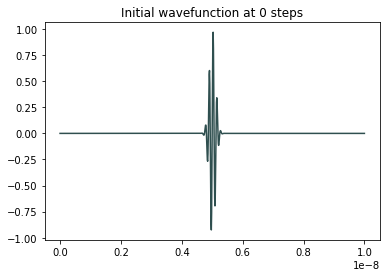

In [27]:
# Solve matrices then plot
psi1 = banded(A, vi, 1, 1)
plot(x, real(psi1), color = 'darkslategray')     # x-axis: x points, y-axis: wavefunction values
title("Initial wavefunction at 0 steps")         # set title
show()                                           # show plot

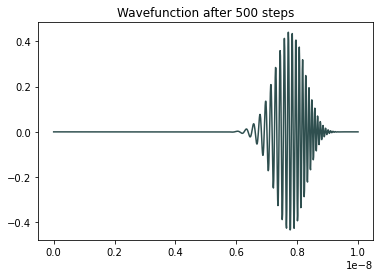

In [28]:
# Crank-Nicolson implementation
for i in range(500):                                       # 500 steps
  vi[1:N] = b1*psi[1:N] + b2*(psi[2:N+1] + psi[0:N-1])    # ith vector assignment
  psi = banded(A, vi, 1, 1)                               # update psi with banded function for the next iteration

# Plot the wavefunction after 1000 Crank-Nicolson steps
plot(x, real(psi), color = 'darkslategray')
title("Wavefunction after 500 steps")
show()

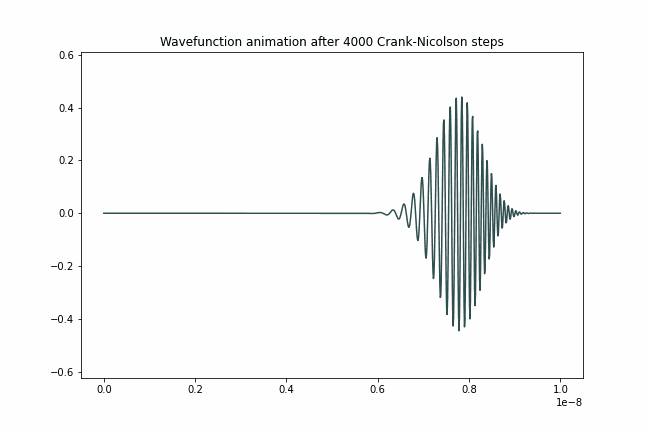

In [29]:
# Initialize a list for the frames to be used in animation
frames = []
# Initialize figure for animation
fig = figure(figsize = (9, 6))    

# Solve for the ith vector components again
vi = zeros(N+1, complex)
vi[1:N] = b1*psi[1:N] + b2*(psi[2:N+1] + psi[0:N-1])

# Apply banded function to psi again
# This will serve as the initial value of psi for the loop
psi = banded(A,vi,1,1)    

# Start of animation loop
for i in range(0, 4000, 1):             # 4000 steps
  vi = zeros(N+1, complex)              # initialize an array of zeros for ith vector
  vi[1:N] = b1*psi[1:N] + b2*(psi[2:N+1] + psi[0:N-1])         # assignment
  psi = banded(A, vi, 1,1)              # update value of psi for the next iteration

  if i%10 == 0:                         # checks if index is divisible by 10
    frames.append(plot(x, real(psi), color='darkslategray'))   # append frame for every 10 steps

# Animate
crank = animation.ArtistAnimation(fig, frames, interval = 50, blit = True, repeat_delay = 1000)  # assign the constructed plots and artists
writergif = animation.PillowWriter(fps = 30)                          # set frames per second
title('Wavefunction animation after 4000 Crank-Nicolson steps')       # set title
crank.save('Cranky.gif', writer = writergif)                          # save animation
close()                                                               # close current figure

# Display gif
Image(filename = "Cranky.gif")

### PROBLEM 2 (50 pts.; 50/50 for code & discussion)

**The Schrodinger equation and the spectral method**

_Refer to Exercise 9.9 in the Newman text._ In this problem, you will use the spectral method to solve the time-dependent Schodinger equation for the same system as in Problem 1, a single particle in one dimension in a box of length $L$ with impenetrable walls. 

To perform the fast transforms needed for this problem, you can use the scipy $\tt fftpack$ package's discrete sine transform $\tt dst$ ([documentation](https://docs.scipy.org/doc/scipy/reference/generated/scipy.fftpack.dst.html)) and inverse discrete sine transform $\tt idst$ ([documentation](https://docs.scipy.org/doc/scipy/reference/generated/scipy.fftpack.idst.html)). Alternatively, you can use the corresponding functions in the $\tt dcst$ package in Appendix E of the Newman text. 

1. Calculate the values of the coefficients $b_k$ which for convenience can be broken down into their real and imaginary parts as $b_k = \alpha_k + i \eta_k$· Divide the box into $N = 1000$ slices and create two arrays containing the real and imaginary parts of $\psi(x_n,0)$ at each grid point. Perform discrete sine transforms on each array separately and hence calculate the values of the $\alpha_k$ and $\eta_k$ for all $k=1$...$N-1$. *(15 pts.)*

2. Putting $b_k = \alpha_k +i \eta_k$ in the solution above and taking the real part we get $ {\rm Re}\ \psi(x_n, t) $ equals
$$\frac{1}{N} \sum_{k=1}^{N-1} \left[\alpha_k \cos\left(\frac{\pi^2\hbar k^2}{2ML^2}t\right) - \eta_k \sin\left(\frac{\pi^2\hbar k^2}{2ML^2}t\right)\right]\sin\left(\frac{\pi kn}{N}\right)$$
for the real part of the wavefunction. This is an inverse sine transform with coefficients equal to the quantities in the square brackets. 

   Calculate the real part of the wavefunction $\psi(x,t)$ at an arbitrary time $t$ using this formula and the inverse discrete sine transform function. *(10 pts.)* 
   
3. Test your program by making a graph of the wavefunction at time $t = 10^{-16}$ s. *(10 pts.)*

4. Make an animation of the wavefunction over time, similar to that described in part (4) of Problem 1 above. A suitable time interval for each frame of the animation is about $10^{-18}$ s. Run your animation for a while and describe what you see. Write a few sentences explaining in physics terms what is going on in the system. *(15 pts.)*


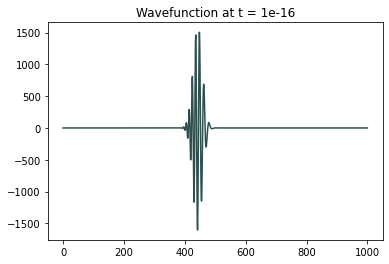

In [17]:
# Define variables
# We use the same set but i put them here again for visualization
h = 1e-18                      # time-step
hbar = 1.0546e-34              # planck's eponymous constant
M = 9.109e-31                  # electron mass in kg
L = 1e-8                       # length in m
N = 1000                       # slices     
x0 = L/2                       # initial value of x
sigma = 1e-10                  # constant
k = 5e10                       # constant
a = L/N                        # width
time = 1e-16                   # time constant

# Define a function which takes both the real and imaginary part of a specified function
def real_imag(func, x): 
    re = func(x).real        # takes real part
    im = func(x).imag        # takes imaginary part
    return re, im            # returns real part and imaginary part

# Initialize arrays of zeros for the real parts and imaginary parts
real_parts = zeros(N+1, float)
imag_parts = zeros(N+1, float)

# Assign the elements of the real array and imaginary array
# Input psi0 function as parameter to func
for i in range(N+1):                                          # loops through all 1001 elements 
    real_parts[i], imag_parts[i] = real_imag(psi0, i*a)       # assigns real part of solution to real array
                                                              # assigns imaginary part of solution to imaginary array
# Solve for the real and imaginary coefficients using dst function from scipy                                                              
alpha = dst(real_parts)       # real                               
eta = dst(imag_parts)         # imaginary

# Define solution of the real part of the wavefunction
def real_psi(t):
    real_solution = zeros(N+1, complex)                       # initialize array
    for k in range(0, N+1):                                   # loops through all 1001 elements
        real_solution[k] = alpha[k]*cos(((pi**2*hbar*k**2)/(2*M*L**2))*t) - eta[k]*sin(((pi**2*hbar*k**2)/(2*M*L**2))*t)     # Newman formula for real part
    inversed = idst(real_solution)                            # apply inverse idst to the constructed array
    return inversed.real                                      # returns the real parts

# Plot
plot(real_psi(time), color = 'darkslategray')     # set time parameter
title("Wavefunction at t = 1e-16")                # set title
show()

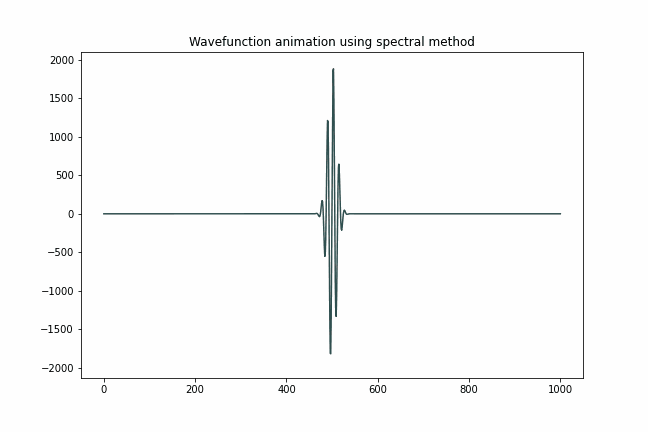

In [25]:
# Initialize a list for the frames to be used in animation
spectral = []                           
# Initialize figure for animation
fig2 = figure(figsize = (9, 6))       

# Create an array of evenly spaced points with 1e-18 intervals
t_pts = arange(0,4000*h,h)         # time intervals

# Loops through length of time values array
for t in range(len(t_pts)): 
  if t%10 == 0:                                                            # checks if index is divisible by 10
    spectral.append(plot(real_psi(t_pts[t]), color = 'darkslategray'))     # append frame to the list for every 10 steps

# Animate similarly as before
spec = animation.ArtistAnimation(fig2, spectral, interval = 50, blit = True, repeat_delay = 1000)  # assign the constructed plots and artists
writergif2 = animation.PillowWriter(fps = 30)                              # assign PillowWriter animation as writergif2
title('Wavefunction animation using spectral method')                      # set title
spec.save('Spectral.gif', writer=writergif2)                               # save animation
close()                                                                    # close current figure

# Display gif
Image(filename = "Spectral.gif")